# Sierra Leone Solar Data Analysis


## Data Loading


In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from scipy.stats import zscore

# Load Sierra Leone dataset
df = pd.read_csv('C:/Users/hp/Desktop/KAIM/Technical Content-20250515T164453Z-1-001/Technical Content/data/data/sierraleone-bumbuna.csv')
df["Timestamp"] = pd.to_datetime(df["Timestamp"], format="%Y-%m-%d %H:%M", errors="coerce")
df.drop(columns=["Comments"], inplace=True)  # Drop if 100% missing
print("Columns:", df.columns)
print("First few rows:\n", df.head())


Columns: Index(['Timestamp', 'GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'Tamb', 'RH', 'WS',
       'WSgust', 'WSstdev', 'WD', 'WDstdev', 'BP', 'Cleaning', 'Precipitation',
       'TModA', 'TModB'],
      dtype='object')
First few rows:
             Timestamp  GHI  DNI  DHI  ModA  ModB  Tamb    RH   WS  WSgust  \
0 2021-10-30 00:01:00 -0.7 -0.1 -0.8   0.0   0.0  21.9  99.1  0.0     0.0   
1 2021-10-30 00:02:00 -0.7 -0.1 -0.8   0.0   0.0  21.9  99.2  0.0     0.0   
2 2021-10-30 00:03:00 -0.7 -0.1 -0.8   0.0   0.0  21.9  99.2  0.0     0.0   
3 2021-10-30 00:04:00 -0.7  0.0 -0.8   0.0   0.0  21.9  99.3  0.0     0.0   
4 2021-10-30 00:05:00 -0.7 -0.1 -0.8   0.0   0.0  21.9  99.3  0.0     0.0   

   WSstdev   WD  WDstdev    BP  Cleaning  Precipitation  TModA  TModB  
0      0.0  0.0      0.0  1002         0            0.0   22.3   22.6  
1      0.0  0.0      0.0  1002         0            0.0   22.3   22.6  
2      0.0  0.0      0.0  1002         0            0.0   22.3   22.6  
3      0.0  0.0   

## Data Profiling


In [9]:
# Summary statistics
print("Summary Statistics:")
print(df.describe())

# Missing values
print("\nMissing Values:")
missing = df.isna().sum()
print(missing)
print("\nColumns with >5% Missing Values:")
print(missing[missing > len(df) * 0.05])

Summary Statistics:
                           Timestamp            GHI            DNI  \
count                         525600  525600.000000  525600.000000   
mean   2022-04-30 12:00:30.000000768     201.957515     116.376337   
min              2021-10-30 00:01:00     -19.500000      -7.800000   
25%              2022-01-29 06:00:45      -2.800000      -0.300000   
50%              2022-04-30 12:00:30       0.300000      -0.100000   
75%              2022-07-30 18:00:15     362.400000     107.000000   
max              2022-10-30 00:00:00    1499.000000     946.000000   
std                              NaN     298.495150     218.652659   

                 DHI           ModA           ModB           Tamb  \
count  525600.000000  525600.000000  525600.000000  525600.000000   
mean      113.720571     206.643095     198.114691      26.319394   
min       -17.900000       0.000000       0.000000      12.300000   
25%        -3.800000       0.000000       0.000000      23.100000   
50% 

## Data Cleaning


In [16]:
# Compute Z-scores for key numeric columns
numeric_cols = ["GHI", "DNI", "DHI", "ModA", "ModB", "WS", "WSgust"]
z_scores = df[numeric_cols].apply(zscore)
print("Rows with |Z|>3:")
print((z_scores.abs() > 3).sum())

# Remove outliers (|Z|>3) while preserving non-numeric columns
df = df[(z_scores.abs() <= 3).all(axis=1)]

# Export cleaned data
df.to_csv("C:/Users/hp/Desktop/KAIM/Technical Content-20250515T164453Z-1-001/Technical Content/data/data/sierra_leone_clean.csv", index=False)
print("Cleaned DataFrame Shape:", df.shape)
print("Columns after cleaning:", df.columns)
print("Outlier removal summary:")
print("Original rows:", 525600)
print("Remaining rows:", df.shape[0])
print("Percentage removed:", round((525600 - df.shape[0]) / 525600 * 100, 2), "%")


Rows with |Z|>3:
GHI        3097
DNI       10111
DHI         815
ModA       2369
ModB       2722
WS            0
WSgust        0
dtype: int64
Cleaned DataFrame Shape: (472139, 18)
Columns after cleaning: Index(['Timestamp', 'GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'Tamb', 'RH', 'WS',
       'WSgust', 'WSstdev', 'WD', 'WDstdev', 'BP', 'Cleaning', 'Precipitation',
       'TModA', 'TModB'],
      dtype='object')
Outlier removal summary:
Original rows: 525600
Remaining rows: 472139
Percentage removed: 10.17 %


## Exploratory Data Analysis (EDA)


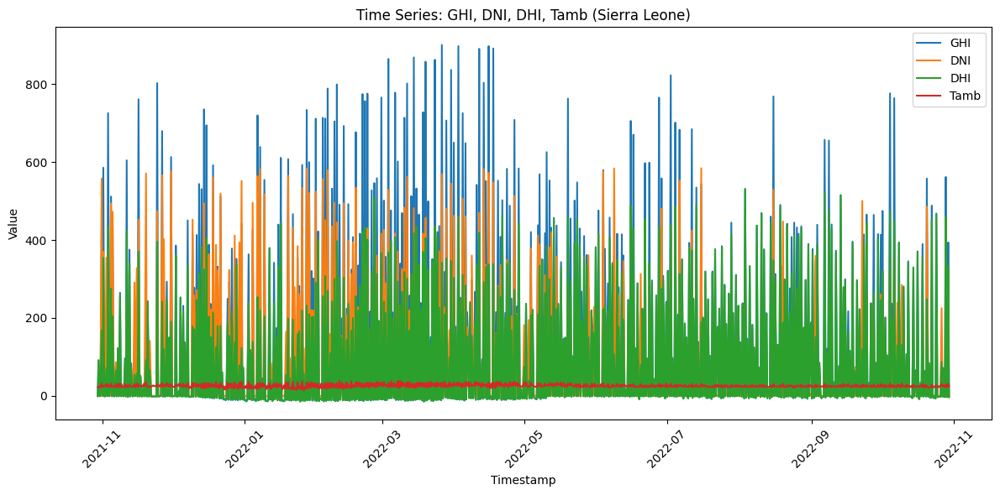

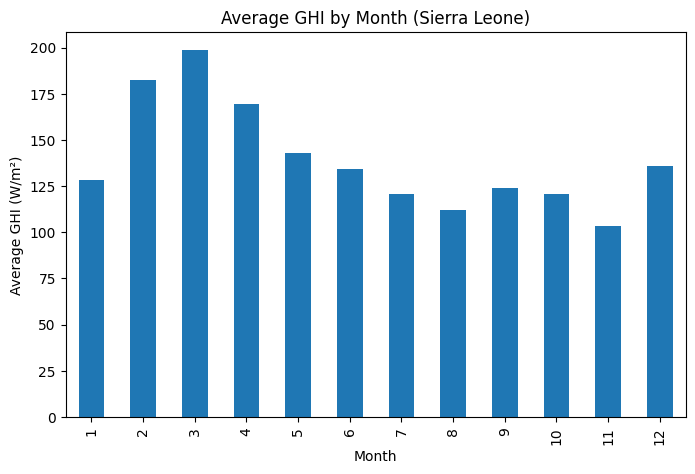

In [17]:
plt.figure(figsize=(12, 6))
plt.plot(df["Timestamp"][::500], df["GHI"][::500], label="GHI")
plt.plot(df["Timestamp"][::500], df["DNI"][::500], label="DNI")
plt.plot(df["Timestamp"][::500], df["DHI"][::500], label="DHI")
plt.plot(df["Timestamp"][::500], df["Tamb"][::500], label="Tamb")
plt.xlabel("Timestamp")
plt.ylabel("Value")
plt.title("Time Series: GHI, DNI, DHI, Tamb (Sierra Leone)")
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

df["Month"] = df["Timestamp"].dt.month
monthly_ghi = df.groupby("Month")["GHI"].mean()
plt.figure(figsize=(8, 5))
monthly_ghi.plot(kind="bar")
plt.xlabel("Month")
plt.ylabel("Average GHI (W/m²)")
plt.title("Average GHI by Month (Sierra Leone)")
plt.show()

## Cleaning Impact


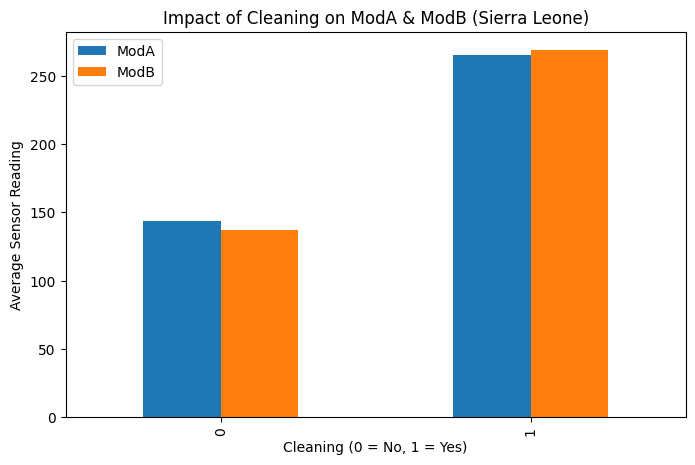

In [18]:
cleaning_impact = df.groupby("Cleaning")[["ModA", "ModB"]].mean()
cleaning_impact.plot(kind="bar", figsize=(8, 5))
plt.xlabel("Cleaning (0 = No, 1 = Yes)")
plt.ylabel("Average Sensor Reading")
plt.title("Impact of Cleaning on ModA & ModB (Sierra Leone)")
plt.show()

## Correlation & Relationship Analysis


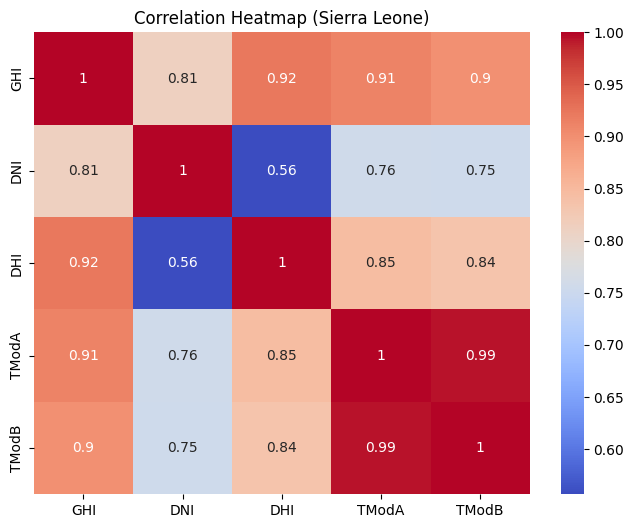

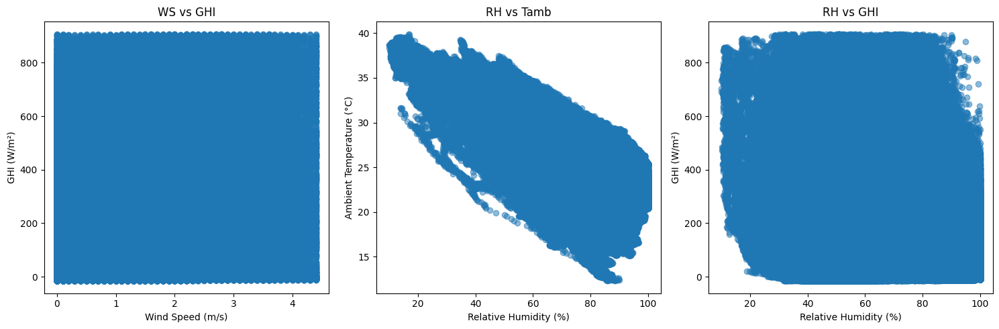

In [19]:
plt.figure(figsize=(8, 6))
sns.heatmap(df[["GHI", "DNI", "DHI", "TModA", "TModB"]].corr(), annot=True, cmap="coolwarm")
plt.title("Correlation Heatmap (Sierra Leone)")
plt.show()

plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.scatter(df["WS"], df["GHI"], alpha=0.5)
plt.xlabel("Wind Speed (m/s)")
plt.ylabel("GHI (W/m²)")
plt.title("WS vs GHI")
plt.subplot(1, 3, 2)
plt.scatter(df["RH"], df["Tamb"], alpha=0.5)
plt.xlabel("Relative Humidity (%)")
plt.ylabel("Ambient Temperature (°C)")
plt.title("RH vs Tamb")
plt.subplot(1, 3, 3)
plt.scatter(df["RH"], df["GHI"], alpha=0.5)
plt.xlabel("Relative Humidity (%)")
plt.ylabel("GHI (W/m²)")
plt.title("RH vs GHI")
plt.tight_layout()
plt.show()

## Wind & Distribution Analysis


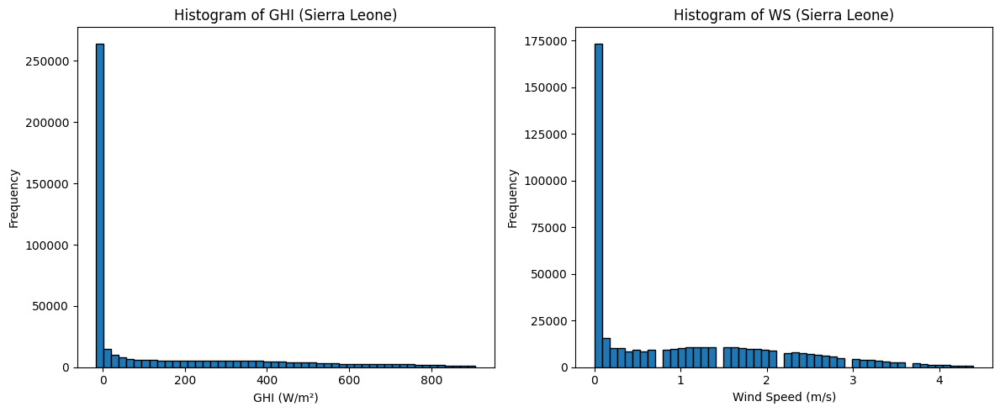

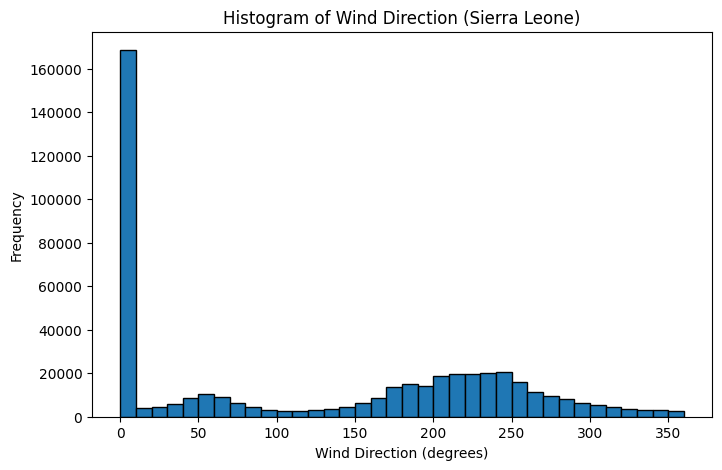

In [20]:
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.hist(df["GHI"], bins=50, edgecolor="black")
plt.xlabel("GHI (W/m²)")
plt.ylabel("Frequency")
plt.title("Histogram of GHI (Sierra Leone)")

plt.subplot(1, 2, 2)
plt.hist(df["WS"], bins=50, edgecolor="black")
plt.xlabel("Wind Speed (m/s)")
plt.ylabel("Frequency")
plt.title("Histogram of WS (Sierra Leone)")
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 5))
plt.hist(df["WD"], bins=36, edgecolor="black")
plt.xlabel("Wind Direction (degrees)")
plt.ylabel("Frequency")
plt.title("Histogram of Wind Direction (Sierra Leone)")
plt.show()

## Temperature Analysis


In [21]:
print("Correlation between RH and Tamb:", df["RH"].corr(df["Tamb"]))
print("Correlation between RH and GHI:", df["RH"].corr(df["GHI"]))

Correlation between RH and Tamb: -0.7695885021577863
Correlation between RH and GHI: -0.534848602855378


## Bubble Chart


In [22]:
fig = px.scatter(df, x="Tamb", y="GHI", size="RH", color="BP",
                 title="Bubble Chart: GHI vs Tamb (Sierra Leone)")
fig.show()

## Summary and Insights